In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from sklearn.neighbors import LocalOutlierFactor
from matplotlib import pyplot as plt


In [2]:
df = pd.read_csv("nuovo_dataset_totale.csv")

In [3]:
df.head()

,Unnamed: 0,id,name,disc_number,duration_ms,explicit,popularity,track_number,artists,album_type,...,valence,tempo,time_signature,tempo_confidence,time_signature_confidence,key_confidence,mode_confidence,n_bars,genre,popularity_artist
0,0,4rjA5kJJWbwU1prXCvg6Fk,Grey,1.0,290.48,False,52.0,5.0,Kölsch,album,...,0.24,186.00,3.0,0.02,1.00,0.50,0.52,234.0,minimal-techno,[51.0]
1,1,6xzpUzzIquIyUzTLbbgSdI,Thrown,1.0,539.23,False,45.0,5.0,Kiasmos,album,...,0.14,120.02,4.0,0.68,0.33,0.41,0.59,269.0,minimal-techno,[47.0]
2,2,56tXgHlSHCfgmGhwVXNizc,Routine,1.0,264.20,False,39.0,5.0,Joris Delacroix,album,...,0.32,118.05,3.0,0.85,0.46,0.90,0.76,171.0,minimal-techno,[44.0]
3,3,0s3wIBczp6TdSJ2y8cveJl,Confronted - Anfisa Letyago Stranger Remix,1.0,387.41,False,0.0,6.0,Pan-Pot;Anfisa Letyago,single,...,0.04,128.99,4.0,0.88,0.50,0.51,0.50,207.0,minimal-techno,"[36.0, 40.0]"
4,4,4PSbDDd1LRYMhqPXvza6I2,Jupiter Sunrise,1.0,248.96,False,0.0,1.0,Kollektiv Turmstrasse,compilation,...,0.12,120.00,4.0,0.88,1.00,0.47,0.46,123.0,minimal-techno,[45.0]


In [5]:
# Select only numeric columns
numeric_df = df.select_dtypes(include=np.number)

from sklearn.preprocessing import StandardScaler
scl = StandardScaler()
X = scl.fit_transform(numeric_df)

In [4]:
from sklearn.neighbors import LocalOutlierFactor
from sklearn.metrics import silhouette_score


# DA RIVEDERE: sembra preferire indipendentemente valori di k sempre più grandi per massimizzare la sihlouette

# Assuming your dataframe is called df

# Define range of k values for LOF
k_values = [15, 20, 25, 30, 35]

best_k = None
best_silhouette = -1

for k in k_values:
    # Create LOF model
    lof = LocalOutlierFactor(n_neighbors=k)

    # Print the current value of k being tested
    print("Testing with k =", k)

    # Fit model and predict labels
    labels = lof.fit_predict(X)

    # Calculate silhouette score
    silhouette = silhouette_score(X, labels)

    # Update best k and silhouette score if needed
    if silhouette > best_silhouette:
        best_k = k
        best_silhouette = silhouette

print("Best k:", best_k)
print("Best silhouette score:", best_silhouette)


Testing with k = 15
Testing with k = 20
Testing with k = 25
Testing with k = 30
Testing with k = 35
Best k: 35
Best silhouette score: 0.2744143107039825


In [9]:
from sklearn.neighbors import LocalOutlierFactor
from sklearn.metrics import silhouette_score
# Assuming your dataframe is called X

silhouette_scores = []

for k in range(1,35):
    # Create LOF model
    lof = LocalOutlierFactor(n_neighbors=k)

    # Print the current value of k being tested
    print("Testing with k =", k)

    # Fit model and predict labels
    labels = lof.fit_predict(X)

    # Calculate silhouette score
    silhouette = silhouette_score(X, labels)
    silhouette_scores.append(silhouette)

# Plot the elbow curve
plt.plot(k_values, silhouette_scores, marker='o')
plt.xlabel('Number of Neighbors (k)')
plt.ylabel('Silhouette Score')
plt.title('Elbow Curve for Local Outlier Factor')
plt.grid(True)
plt.show()


Testing with k = 1
Testing with k = 2
Testing with k = 3
Testing with k = 4
Testing with k = 5
Testing with k = 6
Testing with k = 7
Testing with k = 8
Testing with k = 9
Testing with k = 10
Testing with k = 11
Testing with k = 12
Testing with k = 13


In [16]:
clf = LocalOutlierFactor(n_neighbors=15) # , novelty=True
y_pred = clf.fit_predict(X)
np.unique(y_pred, return_counts=True)

(array([-1,  1]), array([   943, 108206], dtype=int64))

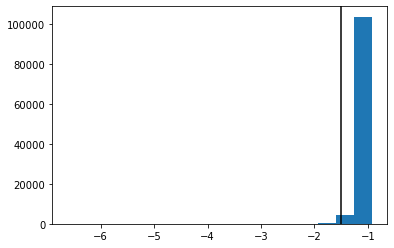

In [17]:
plt.hist(clf.negative_outlier_factor_, bins=17) # bins log2n+1 using 100k
plt.axvline(np.min(clf.negative_outlier_factor_[np.where(y_pred==1)]), c='k')
plt.show()

# Metodo 1: li elimino

In [18]:
outliers = df.loc[np.where(y_pred==-1)].select_dtypes(include=np.number)

In [19]:
outliers

,Unnamed: 0,disc_number,duration_ms,popularity,track_number,album_total_tracks,danceability,energy,key,loudness,...,instrumentalness,liveness,valence,tempo,time_signature,tempo_confidence,time_signature_confidence,key_confidence,mode_confidence,n_bars
123,123,1.0,167.54,1.0,8.0,20.0,0.79,0.96,8.0,-7.13,...,0.44,0.07,0.43,127.99,4.0,0.91,1.00,0.00,0.18,88.0
206,206,1.0,436.47,13.0,4.0,4.0,0.79,0.76,11.0,-8.46,...,0.94,0.11,0.11,134.01,3.0,0.98,1.00,0.58,0.49,323.0
217,217,1.0,502.61,0.0,2.0,12.0,0.92,0.34,0.0,-10.52,...,0.63,0.11,0.89,129.96,4.0,0.94,1.00,0.67,0.51,272.0
241,241,1.0,182.41,22.0,28.0,52.0,0.84,0.79,7.0,-2.80,...,0.00,0.03,0.57,125.07,4.0,0.87,1.00,0.73,0.64,93.0
247,247,1.0,248.77,0.0,30.0,37.0,0.68,0.91,3.0,-4.03,...,0.00,0.35,0.92,95.00,4.0,0.59,1.00,0.25,0.38,96.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
108764,109162,1.0,253.49,0.0,12.0,15.0,0.65,0.56,9.0,-8.07,...,0.00,0.07,0.52,167.33,4.0,0.24,0.86,0.56,0.42,172.0
108899,109297,1.0,174.00,34.0,1.0,1.0,0.51,0.92,5.0,-4.79,...,0.00,0.19,0.31,150.02,5.0,0.55,0.27,1.00,1.00,107.0
108977,109375,1.0,304.48,0.0,1.0,1.0,0.19,0.82,9.0,-6.20,...,0.00,0.12,0.07,76.49,3.0,0.10,0.36,0.49,0.55,128.0
109108,109506,1.0,398.75,0.0,38.0,39.0,0.48,0.88,8.0,-7.69,...,0.05,0.18,0.03,144.01,4.0,0.53,0.41,0.21,0.35,238.0


In [20]:
# Identify outlier rows in sub_df
outlier_indices = outliers.index

# Remove outlier rows from original_df
cleaned_df = df.drop(outlier_indices)

# cleaned_df now contains original_df without the outlier rows

In [21]:
cleaned_df

,Unnamed: 0,id,name,disc_number,duration_ms,explicit,popularity,track_number,artists,album_type,...,valence,tempo,time_signature,tempo_confidence,time_signature_confidence,key_confidence,mode_confidence,n_bars,genre,popularity_artist
0,0,4rjA5kJJWbwU1prXCvg6Fk,Grey,1.0,290.48,False,52.0,5.0,Kölsch,album,...,0.24,186.00,3.0,0.02,1.00,0.50,0.52,234.0,minimal-techno,[51.0]
1,1,6xzpUzzIquIyUzTLbbgSdI,Thrown,1.0,539.23,False,45.0,5.0,Kiasmos,album,...,0.14,120.02,4.0,0.68,0.33,0.41,0.59,269.0,minimal-techno,[47.0]
2,2,56tXgHlSHCfgmGhwVXNizc,Routine,1.0,264.20,False,39.0,5.0,Joris Delacroix,album,...,0.32,118.05,3.0,0.85,0.46,0.90,0.76,171.0,minimal-techno,[44.0]
3,3,0s3wIBczp6TdSJ2y8cveJl,Confronted - Anfisa Letyago Stranger Remix,1.0,387.41,False,0.0,6.0,Pan-Pot;Anfisa Letyago,single,...,0.04,128.99,4.0,0.88,0.50,0.51,0.50,207.0,minimal-techno,"[36.0, 40.0]"
4,4,4PSbDDd1LRYMhqPXvza6I2,Jupiter Sunrise,1.0,248.96,False,0.0,1.0,Kollektiv Turmstrasse,compilation,...,0.12,120.00,4.0,0.88,1.00,0.47,0.46,123.0,minimal-techno,[45.0]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
109144,109542,0wiDjWz3U1WfwXSrWHXe2b,I'm Good (Blue) - REAPER Extended Remix,1.0,209.66,True,23.0,2.0,David Guetta;Bebe Rexha;REAPER,single,...,0.37,173.96,4.0,0.73,1.00,0.09,0.18,145.0,edm,"[86.0, 79.0, 50.0]"
109145,109543,46n9OJc7LOIVdj8t2l5WA5,End Of The Night,1.0,205.72,True,56.0,1.0,Danny Avila,single,...,0.31,99.97,4.0,0.71,1.00,0.40,0.54,84.0,edm,[47.0]
109146,109544,127uq83uGFapbddqiMUKky,Sexy Bitch (feat. Akon),1.0,195.85,True,80.0,3.0,David Guetta;Akon,album,...,0.80,130.01,4.0,0.81,0.99,0.10,0.33,106.0,edm,"[86.0, 79.0]"
109147,109545,0ZdUHFxifUJNqo7G4aJzoF,Savannah,1.0,208.70,False,60.0,1.0,Diviners;Philly K.,single,...,0.39,108.07,4.0,0.65,1.00,0.55,0.60,89.0,edm,"[47.0, 38.0]"


# Metodo 2: sostituisco con moda/mediana

In [22]:
# Identify outlier rows in sub_df
outlier_indices = outliers.index

# Calculate mean values of each column excluding outlier rows
non_outlier_data = df.drop(outlier_indices).select_dtypes(include=np.number).values
means = np.mean(non_outlier_data, axis=0)

# Replace outlier values with means using NumPy indexing
numeric_columns = df.select_dtypes(include=np.number).columns
df.loc[outlier_indices, numeric_columns] = means

# original_df now contains outlier rows replaced with means of each column


In [23]:
df.loc[outlier_indices]

,Unnamed: 0,id,name,disc_number,duration_ms,explicit,popularity,track_number,artists,album_type,...,valence,tempo,time_signature,tempo_confidence,time_signature_confidence,key_confidence,mode_confidence,n_bars,genre,popularity_artist
123,54675.422315,08BqoUf5946hrDb2jrxdyU,Ultra Like,1.024758,227.918985,False,31.813772,8.359361,Raumakustik,compilation,...,0.474563,122.166609,3.901817,0.447202,0.882727,0.489149,0.511327,117.116509,minimal-techno,[30.0]
206,54675.422315,4jKnZ2a3IZOAzlyC5ADWjK,Prism,1.024758,227.918985,False,31.813772,8.359361,Ben Klock;Fadi Mohem,single,...,0.474563,122.166609,3.901817,0.447202,0.882727,0.489149,0.511327,117.116509,minimal-techno,"[30.0, 20.0]"
217,54675.422315,2mUVRJuqQDjiQHzsQrZ0mg,Don't Worry - Original,1.024758,227.918985,False,31.813772,8.359361,Anthony Rother,album,...,0.474563,122.166609,3.901817,0.447202,0.882727,0.489149,0.511327,117.116509,minimal-techno,[30.0]
241,54675.422315,1dVZeuQFWzSI22d3hPEncI,BOMBÓN,1.024758,227.918985,True,31.813772,8.359361,Daddy Yankee;El Alfa;Lil Jon,compilation,...,0.474563,122.166609,3.901817,0.447202,0.882727,0.489149,0.511327,117.116509,hip-hop,"[85.0, 76.0, 71.0]"
247,54675.422315,0zhxUjkXag9iEFccaiua4a,RUMBATÓN,1.024758,227.918985,False,31.813772,8.359361,Daddy Yankee,compilation,...,0.474563,122.166609,3.901817,0.447202,0.882727,0.489149,0.511327,117.116509,hip-hop,[85.0]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
108764,54675.422315,15SAAkMN4UoJGKTTfp7dpj,Rasta Words,1.024758,227.918985,False,31.813772,8.359361,Horace Andy,album,...,0.474563,122.166609,3.901817,0.447202,0.882727,0.489149,0.511327,117.116509,dub,[42.0]
108899,54675.422315,5AtfGqKRxHMOkuW4V2dpiW,Children,1.024758,227.918985,False,31.813772,8.359361,Shuba Music,single,...,0.474563,122.166609,3.901817,0.447202,0.882727,0.489149,0.511327,117.116509,dubstep,[14.0]
108977,54675.422315,4ecRnOIH03SVhJ3EkuBWxW,Never Be Like You,1.024758,227.918985,False,31.813772,8.359361,Crywolf,single,...,0.474563,122.166609,3.901817,0.447202,0.882727,0.489149,0.511327,117.116509,dubstep,[42.0]
109108,54675.422315,1JqT2GcU9rXFX8PwrzVlUC,LOVE BURNS (Outro) - AMAGII Remix,1.024758,227.918985,False,31.813772,8.359361,NAZAAR;AMAGII,album,...,0.474563,122.166609,3.901817,0.447202,0.882727,0.489149,0.511327,117.116509,dubstep,"[35.0, 0.0]"


# PCA on all dataset

In [24]:
from sklearn.decomposition import PCA

# Initialize PCA with 3 components
pca = PCA(n_components=3)

# Fit PCA to your data and transform it
X_pca = pca.fit_transform(X)

# Now X_pca contains your data with reduced dimensions (3 dimensions)

# Proceed with outlier detection using Local Outlier Factor (LOF) on the reduced data

# Example code for LOF
clf = LocalOutlierFactor(n_neighbors=15)
y_pred = clf.fit_predict(X_pca)
np.unique(y_pred, return_counts=True)

# Now you can plot the reduced data X_pca
# Make sure to plot the data based on the three principal components
# You can use any plotting library like Matplotlib or Plotly for this purpose


(array([-1,  1]), array([   312, 108837], dtype=int64))

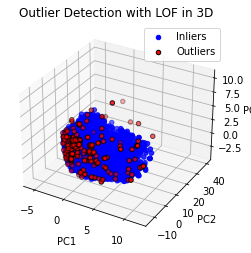

In [25]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Find indices of inliers and outliers
inlier_indices = np.where(y_pred == 1)[0]
outlier_indices = np.where(y_pred == -1)[0]

# Create arrays of inliers and outliers
inliers = X_pca[inlier_indices]
outliers = X_pca[outlier_indices]

# Plot the inliers
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(inliers[:, 0], inliers[:, 1], inliers[:, 2], c='blue', label='Inliers')

# Plot the outliers and highlight them
ax.scatter(outliers[:, 0], outliers[:, 1], outliers[:, 2], c='red', label='Outliers', edgecolors='black')

ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')
ax.set_title('Outlier Detection with LOF in 3D')
ax.legend()
plt.show()


In [26]:
from sklearn.decomposition import PCA

# Initialize PCA with 3 components
pca = PCA(n_components=2)

# Fit PCA to your data and transform it
X_pca = pca.fit_transform(X)

# Now X_pca contains your data with reduced dimensions (3 dimensions)

# Proceed with outlier detection using Local Outlier Factor (LOF) on the reduced data

# Example code for LOF
clf = LocalOutlierFactor(n_neighbors=25)
y_pred = clf.fit_predict(X_pca)
np.unique(y_pred, return_counts=True)

# Now you can plot the reduced data X_pca
# Make sure to plot the data based on the three principal components
# You can use any plotting library like Matplotlib or Plotly for this purpose


(array([-1,  1]), array([   102, 109047], dtype=int64))

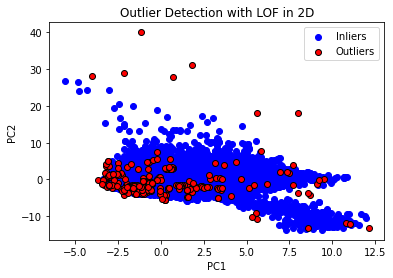

In [27]:
# Create arrays of inliers and outliers
inliers = X_pca[inlier_indices]
outliers = X_pca[outlier_indices]

# Plot the inliers
plt.scatter(inliers[:, 0], inliers[:, 1], c='blue', label='Inliers')

# Plot the outliers and highlight them
plt.scatter(outliers[:, 0], outliers[:, 1], c='red', label='Outliers', edgecolors='black')

plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('Outlier Detection with LOF in 2D')
plt.legend()
plt.show()

In [28]:
# Initialize PCA with 3 components
pca = PCA(n_components=1)

# Fit PCA to your data and transform it
X_pca = pca.fit_transform(X)

# Now X_pca contains your data with reduced dimensions (3 dimensions)

# Proceed with outlier detection using Local Outlier Factor (LOF) on the reduced data

# Example code for LOF
clf = LocalOutlierFactor(n_neighbors=25)
y_pred = clf.fit_predict(X_pca)
np.unique(y_pred, return_counts=True)

# Now you can plot the reduced data X_pca
# Make sure to plot the data based on the three principal components
# You can use any plotting library like Matplotlib or Plotly for this purpose


(array([-1,  1]), array([    15, 109134], dtype=int64))

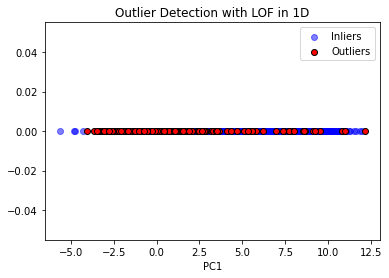

In [29]:
# Create arrays of inliers and outliers
inliers = X_pca[inlier_indices]
outliers = X_pca[outlier_indices]

# Plot the inliers
plt.scatter(inliers[:, 0], np.zeros_like(inliers[:, 0]), c='blue', label='Inliers', alpha=0.5)

# Plot the outliers and highlight them
plt.scatter(outliers[:, 0], np.zeros_like(outliers[:, 0]), c='red', label='Outliers', edgecolors='black')

plt.xlabel('PC1')
plt.title('Outlier Detection with LOF in 1D')
plt.legend()
plt.show()

# Loudness, n_bars

Inliers: 108561
Outliers: 588


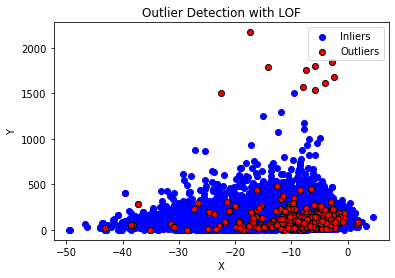

In [32]:
import matplotlib.pyplot as plt

# Find indices of inliers and outliers
inlier_indices = np.where(y_pred == 1)[0]
outlier_indices = np.where(y_pred == -1)[0]

# Create arrays of inliers and outliers
inliers = numeric_df.iloc[inlier_indices]
outliers = numeric_df.iloc[outlier_indices]

# Display counts of inliers and outliers
inlier_count = len(inliers)
outlier_count = len(outliers)
print("Inliers:", inlier_count)
print("Outliers:", outlier_count)

# Rescale the input
inliers_loudness_scaled = inliers['loudness'].values.reshape(-1, 1)
inliers_n_bars_scaled = inliers['n_bars'].values.reshape(-1, 1)
outliers_loudness_scaled = outliers['loudness'].values.reshape(-1, 1)
outliers_n_bars_scaled = outliers['n_bars'].values.reshape(-1, 1)


# Plot the inliers
plt.scatter(inliers_loudness_scaled, inliers_n_bars_scaled, c='blue', label='Inliers')

# Plot the outliers and highlight them
plt.scatter(outliers_loudness_scaled, outliers_n_bars_scaled, c='red', label='Outliers', edgecolors='black')

plt.xlabel('X')
plt.ylabel('Y')
plt.title('Outlier Detection with LOF')
plt.legend()
plt.show()


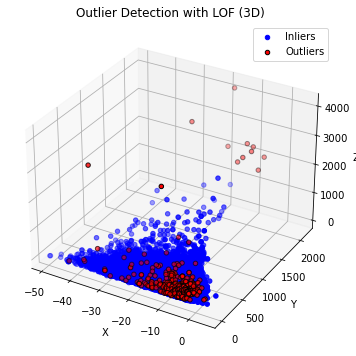

In [33]:
from mpl_toolkits.mplot3d import Axes3D

# Plot the data in 3D
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')

inliers_duration_scaled = inliers['duration_ms'].values.reshape(-1, 1)
outliers_duration_scaled = outliers['duration_ms'].values.reshape(-1, 1)

# Plot the inliers
ax.scatter(inliers_loudness_scaled, inliers_n_bars_scaled, inliers_duration_scaled, c='blue', label='Inliers')

# Plot the outliers and highlight them
ax.scatter(outliers_loudness_scaled, outliers_n_bars_scaled, outliers_duration_scaled, c='red', label='Outliers', edgecolors='black')

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Outlier Detection with LOF (3D)')
ax.legend()

plt.show()

# Plot 2D outliers

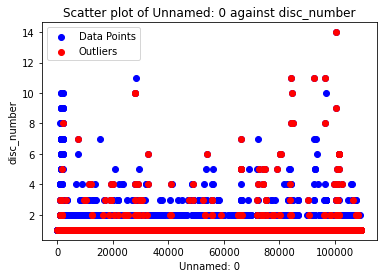

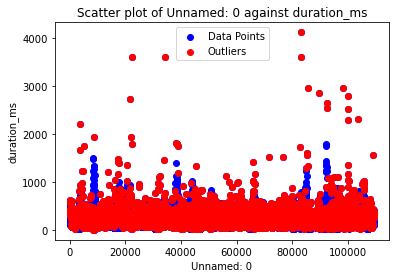

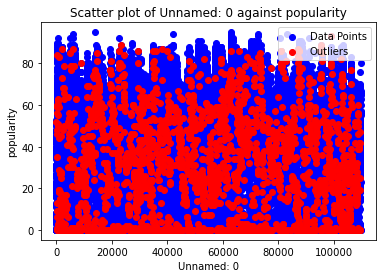

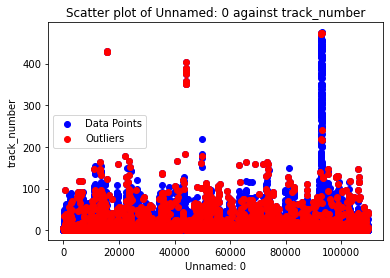

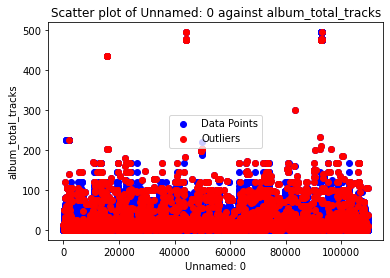

...

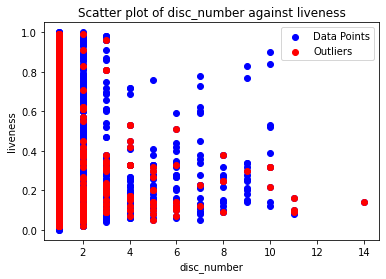

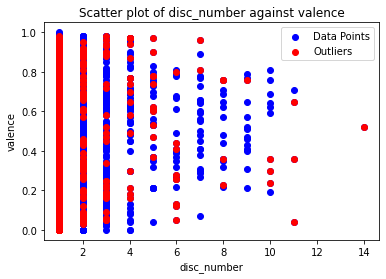

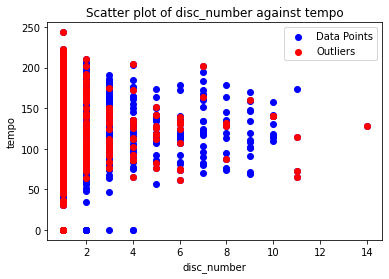

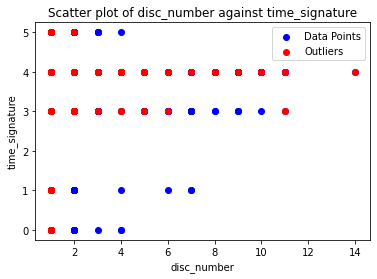

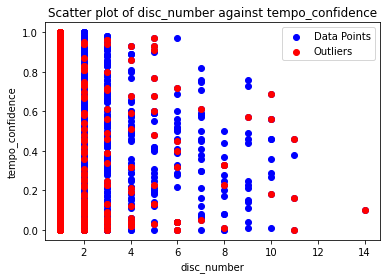

C:\Users\corra\AppData\Roaming\Python\Python39\site-packages\IPython\core\pylabtools.py:151: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



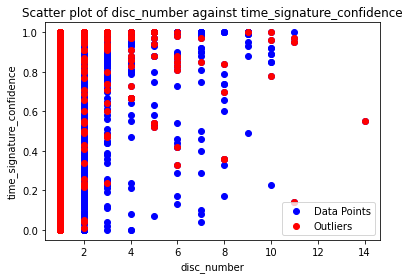

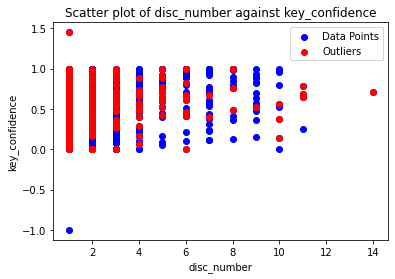

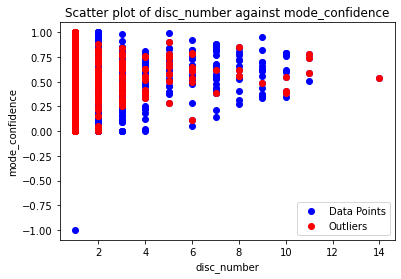

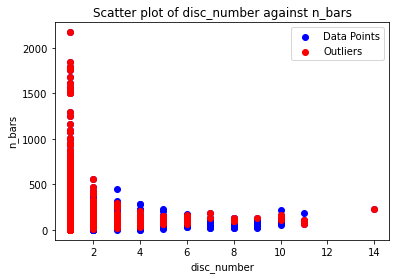

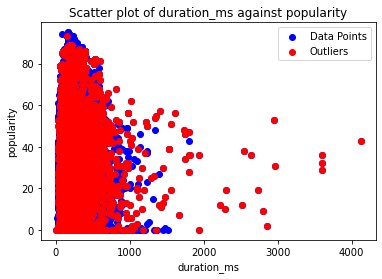

...

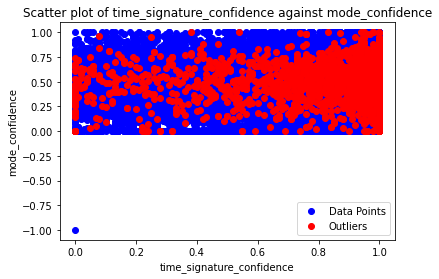

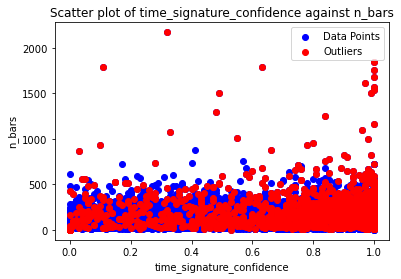

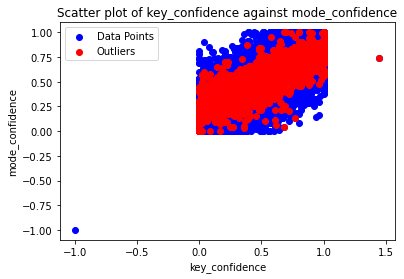

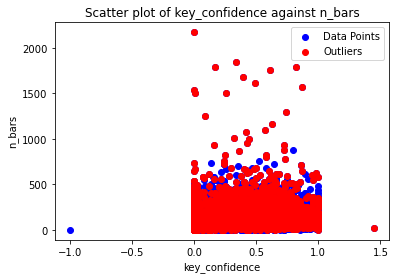

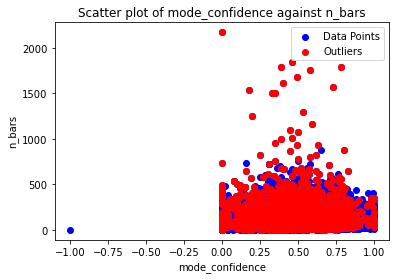

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming your dataframe is called df

# Extract numeric columns from DataFrame
numeric_df = df.select_dtypes(include=np.number).columns

scl = StandardScaler()
X = scl.fit_transform(numeric_df)

# Generate scatter plots for each pair of numeric columns
for i in range(len(X)):
    for j in range(i+1, len(X)):
        col1 = X[i]
        col2 = X[j]
        
        # Extract columns data
        x_data = df[col1]
        y_data = df[col2]
        
        # Create 2D scatter plot
        plt.scatter(x_data, y_data, c='b', marker='o', label='Data Points')

        # Highlight outliers if y_pred variable is defined
        if 'y_pred' in globals():
            outliers = np.where(y_pred == -1)[0]
            plt.scatter(x_data.iloc[outliers], y_data.iloc[outliers], c='r', marker='o', label='Outliers')
        
        plt.xlabel(col1)
        plt.ylabel(col2)
        plt.title(f"Scatter plot of {col1} against {col2}")
        plt.legend()
        plt.show()


# Plot 3D

## Loudness, n_bars, duration_ms

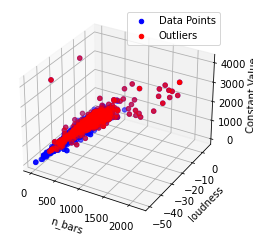

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Assuming your dataframe is called df

# Extract "loudness" and "n_bars" columns
loudness = df["loudness"]
n_bars = df["n_bars"]

# Set a constant value for the third dimension
constant_value = df["duration_ms"]  # You can change this to any constant value you want

# Create 3D scatter plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Plot data points
ax.scatter(n_bars, loudness, constant_value, c='b', marker='o', label='Data Points')

# Highlight outliers
if 'y_pred' in globals():
    outliers = np.where(y_pred == -1)[0]
    ax.scatter(n_bars.iloc[outliers], loudness.iloc[outliers], constant_value.iloc[outliers], c='r', marker='o', label='Outliers')

ax.set_xlabel("n_bars")
ax.set_ylabel("loudness")
ax.set_zlabel("Constant Value")
ax.legend()
plt.show()


In [ ]:
import cufflinks as cf
import plotly.graph_objs as go

# Assuming your dataframe is called df

# Extract "loudness", "n_bars", and "some_other_feature" columns
loudness = df["loudness"]
n_bars = df["n_bars"]
some_other_feature = df["duration_ms"]

# Create a DataFrame with the extracted columns
df_plotly = pd.DataFrame({"n_bars": n_bars, "loudness": loudness, "some_other_feature": some_other_feature})

# Create 3D scatter plot
fig = df_plotly.iplot(kind="scatter3d", x="n_bars", y="loudness", z="some_other_feature", asFigure=True)

# Highlight outliers
if 'y_pred' in globals():
    outliers = df_plotly.iloc[np.where(y_pred == -1)[0]]
    fig.add_trace(go.Scatter3d(
        x=outliers["n_bars"],
        y=outliers["loudness"],
        z=outliers["some_other_feature"],
        mode='markers',
        marker=dict(color='red', size=5),
        name='Outliers'
    ))

    # Filter regular points
    regular_points = df_plotly.drop(outliers.index)
    fig.add_trace(go.Scatter3d(
        x=regular_points["n_bars"],
        y=regular_points["loudness"],
        z=regular_points["some_other_feature"],
        mode='markers',
        marker=dict(color='blue', size=5),
        name='Regular Points'
    ))

fig.show()
